In [2]:
#BIBLIOTECAS

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px

In [4]:
#LIMPEZA DE DADOS

In [5]:
df = pd.read_csv('VENDAS_GERAL.csv')

In [6]:
#Verificando dataset

In [7]:
df

,pedido_id,data_criacao,status,produto,categoria,tipo_pagamento,faturamento
0,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,delivered,87285b34884572647811a353c7ac498a,utilidades_domesticas,credit_card,18.12
1,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,delivered,87285b34884572647811a353c7ac498a,utilidades_domesticas,voucher,2.00
2,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,delivered,87285b34884572647811a353c7ac498a,utilidades_domesticas,voucher,18.59
3,53cdb2fc8bc7dce0b6741e2150273451,2018-07-24 20:41:37,delivered,595fac2a385ac33a80bd5114aec74eb8,perfumaria,boleto,141.46
4,47770eb9100c2d0c44946d9cf07ec65d,2018-08-08 08:38:49,delivered,aa4383b373c6aca5d8797843e5594415,automotivo,credit_card,179.12
...,...,...,...,...,...,...,...
118429,63943bddc261676b46f01ca7ac2f7bd8,2018-02-06 12:58:58,delivered,f1d4ce8c6dd66c47bbaa8c6781c2a923,bebes,credit_card,195.00
118430,83c1379a015df1e13d02aae0204711ab,2017-08-27 14:46:43,delivered,b80910977a37536adeddd63663f916ad,eletrodomesticos_2,credit_card,271.01
118431,11c177c8e97725db2631073c19f07b62,2018-01-08 21:28:27,delivered,d1c427060a0f73f6b889a5c7c61f2ac4,informatica_acessorios,credit_card,441.16
118432,11c177c8e97725db2631073c19f07b62,2018-01-08 21:28:27,delivered,d1c427060a0f73f6b889a5c7c61f2ac4,informatica_acessorios,credit_card,441.16


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118434 entries, 0 to 118433
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   pedido_id       118434 non-null  object 
 1   data_criacao    118434 non-null  object 
 2   status          118434 non-null  object 
 3   produto         117604 non-null  object 
 4   categoria       115906 non-null  object 
 5   tipo_pagamento  118431 non-null  object 
 6   faturamento     118431 non-null  float64
dtypes: float64(1), object(6)
memory usage: 6.3+ MB


In [9]:
df.describe()

,faturamento
count,118431.000000
mean,172.849395
std,268.259831
min,0.000000
25%,60.860000
50%,108.200000
75%,189.245000
max,13664.080000


In [10]:
#trocando tipo de dado da coluna 'data_criação'

In [11]:
df['data_criacao'] = pd.to_datetime(df['data_criacao'], errors='coerce')

In [12]:
# verificando as colunas novamente

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118434 entries, 0 to 118433
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   pedido_id       118434 non-null  object        
 1   data_criacao    118434 non-null  datetime64[ns]
 2   status          118434 non-null  object        
 3   produto         117604 non-null  object        
 4   categoria       115906 non-null  object        
 5   tipo_pagamento  118431 non-null  object        
 6   faturamento     118431 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(5)
memory usage: 6.3+ MB


In [14]:
# verificando colunas com NaN no dataframe

In [15]:
df.isnull().sum()

pedido_id            0
data_criacao         0
status               0
produto            830
categoria         2528
tipo_pagamento       3
faturamento          3
dtype: int64

In [16]:
# substituindo nas colunas 'Categoria', 'Produto' e 'tipo_pagamento' valores 'NaN' por 'Não encontrado'. E na coluna de faturamento por 0

In [17]:
df['produto'] = df['produto'].fillna("Não Encontrado")

In [18]:
df['categoria'] = df['categoria'].fillna("Não Encontrado")

In [19]:
df['tipo_pagamento'] = df['tipo_pagamento'].fillna("Não Encontrado")

In [20]:
df['faturamento'] = df['faturamento'].fillna(0)

In [21]:
# apos o preenchimento das colunas, verificando novamente se a valores nulos

In [22]:
df.isnull().sum()

pedido_id         0
data_criacao      0
status            0
produto           0
categoria         0
tipo_pagamento    0
faturamento       0
dtype: int64

In [23]:
# a coluna que será usada nessa visão para calculo de faturamento será a coluna 'faturamento'. Verificando a distribuição de valores para essa coluna

In [24]:
#usando boxplot

In [25]:
#usando escala log

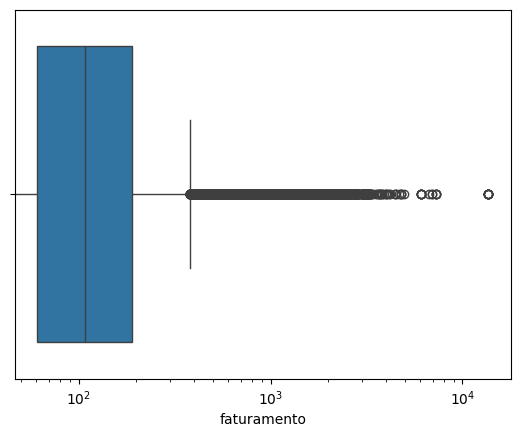

In [26]:
sns.boxplot(x=df['faturamento'])
plt.xscale('log')

In [27]:
# tento em vista que se tem muitos outliers e que todos são de transações validas, então iremos considerar manter os valores outliers para a analise descritiva

In [28]:
#ANALISE DESCRITIVA

1. Total de pedidos 

In [29]:
total_de_pedidos = df['pedido_id'].nunique()

In [30]:
total_de_pedidos

99441

2. Ticket Médio

In [31]:
ticket_médio = round(sum(df['faturamento'])/total_de_pedidos,2)

In [32]:
ticket_médio

205.86

3. Faturamento

In [33]:
faturamento_total = round(sum(df['faturamento']),2)

In [34]:
faturamento_total

20470726.66

4. Top 5 categorias com maior faturamento

In [35]:
import plotly.express as px
import pandas as pd

# Exemplo: agrupando faturamento por método de pagamento
faturamento = df.groupby('categoria')['faturamento'].sum().sort_values(ascending=False)

# Top 5 + Outros
top_5 = faturamento.head(5)

# Transformar em DataFrame
df_plot = top_5.reset_index()
df_plot.columns = ['Categoria de produto', 'Faturamento']

# Criar gráfico de pizza
fig = px.pie(
    df_plot,
    names='Categoria de produto',
    values='Faturamento',
    title='Top Categorias de produto com maior faturamento',
    hole=0,  # 0 para pizza, >0 para rosca
)

# Mostrar porcentagens e valores
fig.update_traces(
    textinfo='percent+label',
    hovertemplate='%{label}<br>Faturamento: R$ %{value:,.0f}<br>%{percent}'
)

# Layout
fig.update_layout(
    width=900,   # largura maior
    height=700,   # altura maior
    showlegend=False
)

    

fig.show()

5. Faturamento por método de pagamento

In [36]:
# Exemplo: agrupando faturamento por método de pagamento
df = df[df['tipo_pagamento'] != "Não Encontrado"]
df = df[df['tipo_pagamento'] != "not_defined"]
faturamento = df.groupby('tipo_pagamento')['faturamento'].sum().sort_values(ascending=False)

# Top 5 + Outros
top_5 = faturamento.head(5)
outros_valor = faturamento.iloc[5:].sum()
if outros_valor > 0:
    top_5.loc['Outros'] = outros_valor

# Transformar em DataFrame
df_plot = top_5.reset_index()
df_plot.columns = ['Método de Pagamento', 'Faturamento']

# Criar gráfico de pizza
fig = px.pie(
    df_plot,
    names='Método de Pagamento',
    values='Faturamento',
    title='Top Métodos de Pagamento com maior faturamento',
    hole=0,  # 0 para pizza, >0 para rosca
)

# Mostrar porcentagens e valores
fig.update_traces(
    textinfo='percent+label',
    hovertemplate='%{label}<br>Faturamento: R$ %{value:,.0f}<br>%{percent}'
)

# Layout
fig.update_layout(
    legend_title_text='Método de Pagamento',
    width=800,   # bem largo
    height=600,   # mais alto
    font=dict(size=16)  # aumenta a fonte de tudo
)

fig.show()


6.  Faturamento por produto

In [37]:
# Supondo que o df original tenha as colunas: produto, faturamento, pedido_id
df_faturamento = df.groupby("produto").agg(
    faturamento=("faturamento", "sum"),
    total_pedidos=("pedido_id", "nunique")  # conta pedidos distintos
).reset_index()

# Calcular ticket médio por produto
df_faturamento["ticket_medio"] = df_faturamento["faturamento"] / df_faturamento["total_pedidos"]

# Remover produtos indesejados
df_faturamento = df_faturamento[df_faturamento['produto'] != "Não Encontrado"] 

# Ordenar pelo faturamento
df_faturamento = df_faturamento.sort_values(by="faturamento", ascending=False)

# Criar tabela estilizada com Plotly
fig = go.Figure(
    data=[go.Table(
        header=dict(
            values=[
                "<b>Produto</b>",
                "<b>Faturamento (R$)</b>",
                "<b>Total de Pedidos</b>",
                "<b>Ticket Médio (R$)</b>"
            ],
            fill_color="royalblue",
            font=dict(color="white", size=14),
            align="center"
        ),
        cells=dict(
            values=[
                df_faturamento['produto'],
                df_faturamento['faturamento'],
                df_faturamento['total_pedidos'],
                df_faturamento['ticket_medio']
            ],
            fill_color=[["lavender", "white"] * (len(df_faturamento)//2 + 1)],
            align="center",
            font=dict(size=12),
            format=["", ",.2f", ",d", ",.2f"]  # formato: R$ e inteiros
        )
    )]
)

# Ajustar layout
fig.update_layout(
    title="Faturamento, Pedidos e Ticket Médio por Produto",
    title_x=0.5,
    width=1200,
    height=800
)

fig.show()

7 - Faturamento ao longo do tempo

In [38]:
import pandas as pd
import plotly.graph_objects as go

# Converter a data
df['data_criacao'] = pd.to_datetime(df['data_criacao'])

# Agrupar por dia
df_dia = df.groupby(df['data_criacao'].dt.date).agg(
    faturamento=('faturamento', 'sum')
).reset_index()

# Renomear para padronizar
df_dia.rename(columns={'data_criacao': 'data'}, inplace=True)

# Criar gráfico sem rótulos
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=df_dia['data'],
    y=df_dia['faturamento'],
    mode='lines+markers',
    fill='tozeroy',
    line=dict(color='navy', width=2),
    marker=dict(size=4, color='royalblue'),
    name='Faturamento diário'
))

# Layout limpo
fig.update_layout(
    title='Faturamento Diário (Estilo Cardiograma - Sem Rótulos)',
    title_x=0.5,
    xaxis_title='Data',
    yaxis_title='Faturamento (R$)',
    yaxis_tickformat=',.0f',
    width=1100,
    height=500,
    plot_bgcolor='white'
)

fig.update_xaxes(showgrid=True, gridcolor='lightgray', tickangle=-45)
fig.update_yaxes(showgrid=True, gridcolor='lightgray')

fig.show()

- SEGUNDA VISÃO 

In [2]:
df_2_v = pd.read_csv('VENDAS_CLIENTE_VENDEDOR_CIDADE.csv')

In [3]:
df_2_v

,DIA,pedido,faturamento,vendedor,cliente,estado,latitude,longitude
0,2017-09-29,03caa2c082116e1d31e67e9ae3700499,13664.08,b37c4c02bda3161a7546a4e6d222d5b2,1617b1357756262bfa56ab541c47bc16,SP,-23.533189,-46.496424
1,2017-09-29,03caa2c082116e1d31e67e9ae3700499,13664.08,b37c4c02bda3161a7546a4e6d222d5b2,1617b1357756262bfa56ab541c47bc16,SP,-23.532942,-46.496253
2,2017-09-29,03caa2c082116e1d31e67e9ae3700499,13664.08,b37c4c02bda3161a7546a4e6d222d5b2,1617b1357756262bfa56ab541c47bc16,SP,-23.532942,-46.496253
3,2017-09-29,03caa2c082116e1d31e67e9ae3700499,13664.08,b37c4c02bda3161a7546a4e6d222d5b2,1617b1357756262bfa56ab541c47bc16,SP,-23.532442,-46.496018
4,2017-09-29,03caa2c082116e1d31e67e9ae3700499,13664.08,b37c4c02bda3161a7546a4e6d222d5b2,1617b1357756262bfa56ab541c47bc16,SP,-23.532329,-46.497213
...,...,...,...,...,...,...,...,...
6159234,2018-07-02,e39fb9d49443326e7e4db4321c5ca18e,144.45,bfd27a966d91cfaafdb25d076585f0da,d845fa10aed9b9761c5e4f3234c15656,SP,-22.613803,-46.703123
6159235,2018-07-02,e39fb9d49443326e7e4db4321c5ca18e,144.45,bfd27a966d91cfaafdb25d076585f0da,d845fa10aed9b9761c5e4f3234c15656,SP,-22.613803,-46.703123
6159236,2018-07-02,e39fb9d49443326e7e4db4321c5ca18e,144.45,bfd27a966d91cfaafdb25d076585f0da,d845fa10aed9b9761c5e4f3234c15656,SP,-22.613803,-46.703123
6159237,2018-07-02,e39fb9d49443326e7e4db4321c5ca18e,144.45,bfd27a966d91cfaafdb25d076585f0da,d845fa10aed9b9761c5e4f3234c15656,SP,-22.613763,-46.697143


In [5]:
df_2_v['estado'].unique()

array(['SP', 'PR', 'GO', 'RS', 'BA', 'RJ', 'MG', 'SC', 'PE', 'PB', 'RN',
       'ES', 'RO', 'DF', 'AM', 'CE', nan, 'MS', 'PI', 'SE', 'MA', 'MT',
       'AC'], dtype=object)

In [41]:
df_2_v.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6159239 entries, 0 to 6159238
Data columns (total 8 columns):
 #   Column       Dtype  
---  ------       -----  
 0   DIA          object 
 1   pedido       object 
 2   faturamento  float64
 3   vendedor     object 
 4   cliente      object 
 5   estado       object 
 6   latitude     float64
 7   longitude    float64
dtypes: float64(3), object(5)
memory usage: 375.9+ MB


In [42]:
df_2_v.isnull().sum()

DIA             0
pedido          0
faturamento     0
vendedor        0
cliente         0
estado         85
latitude       85
longitude      86
dtype: int64

In [43]:
df_2_v['estado'] = df_2_v['estado'].fillna("Não Encontrado")

In [44]:
df_2_v['latitude'] = df_2_v['latitude'].fillna("Não Econtrado")

In [45]:
df_2_v['longitude'] = df_2_v['longitude'].fillna("Não Econtrado")

In [46]:
df_2_v['DIA'] = pd.to_datetime(df_2_v['DIA'], errors='coerce')

agrupando as informações para não sofrer impacto das duplicadas

In [60]:
df_pedidos = df_2_v.groupby("pedido", as_index=False).agg({
    "faturamento": "first",
    "vendedor": "first",
    "cliente": "first",
    "estado": "first",
    "latitude": "first",
    "longitude": "first"
})

1. Faturamento, ticket_medido e total de pedidos por clientes

In [61]:
cliente_stats = (
    df_pedidos.groupby("cliente")
    .agg(
        faturamento_total=("faturamento", "sum"),
        ticket_medio=("faturamento", "mean")
    )
    .reset_index()
    .sort_values(by="faturamento_total", ascending=False)
)

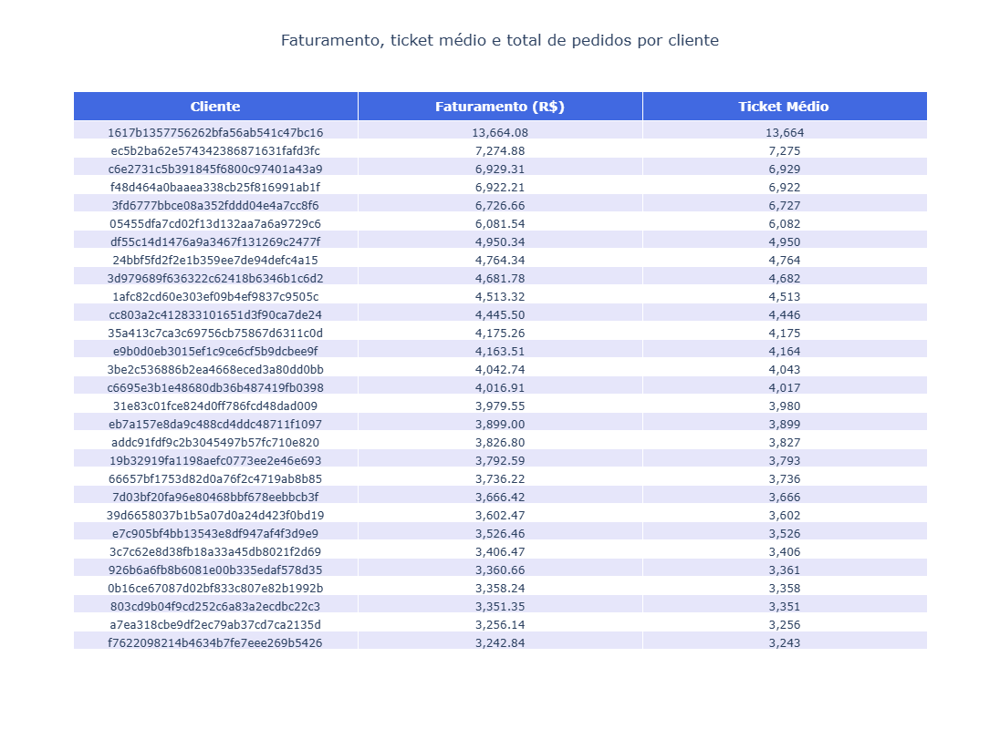

In [62]:
# Criar tabela estilizada com Plotly
cliente_stats = cliente_stats[cliente_stats['cliente'] != "Não Encontrado"]
fig = go.Figure(
    data=[go.Table(
        header=dict(
            values=["<b>Cliente</b>", "<b>Faturamento (R$)</b>", "<b>Ticket Médio</b>"],
            fill_color="royalblue",
            font=dict(color="white", size=14),
            align="center"
        ),
        cells=dict(
            values=[
                cliente_stats['cliente'],
                cliente_stats['faturamento_total'],
                cliente_stats['ticket_medio']
            ],
            fill_color=[["lavender", "white"] * (len(df_faturamento)//2 + 1)],
            align="center",
            font=dict(size=12),
            format=["", ",.2f", ",d"]  # duas casas para faturamento e inteiro p/ pedidos
        )
    )]
)

# Ajustar layout
fig.update_layout(
    title="Faturamento, ticket médio e total de pedidos por cliente",
    title_x=0.5,
    width=1200,
    height=800
)

fig.show()

2. Tota de faturamento, ticket médio e total de pedidos por vendedor

In [50]:
vendedor_stats = df_pedidos.groupby("vendedor").agg(
    faturamento_total=("faturamento", "sum"),
    total_pedidos=("pedido", "count"),
    ticket_medio=("faturamento", "mean")
).reset_index().sort_values(by='faturamento_total', ascending=False)

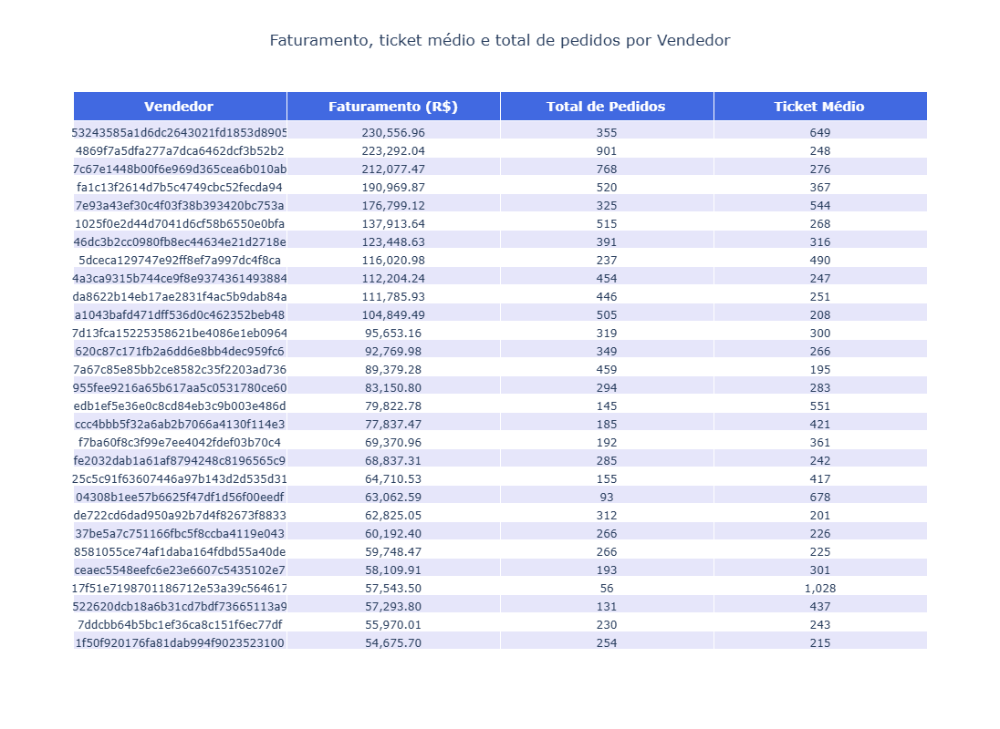

In [51]:
# Criar tabela estilizada com Plotly
vendedor_stats = vendedor_stats[vendedor_stats['vendedor'] != "Não Encontrado"]
fig = go.Figure(
    data=[go.Table(
        header=dict(
            values=["<b>Vendedor</b>", "<b>Faturamento (R$)</b>", "<b>Total de Pedidos</b>", "<b>Ticket Médio</b>"],
            fill_color="royalblue",
            font=dict(color="white", size=14),
            align="center"
        ),
        cells=dict(
            values=[
                vendedor_stats['vendedor'],
                vendedor_stats['faturamento_total'],
                vendedor_stats['total_pedidos'],
                vendedor_stats['ticket_medio']
            ],
            fill_color=[["lavender", "white"] * (len(df_faturamento)//2 + 1)],
            align="center",
            font=dict(size=12),
            format=["", ",.2f", ",d"]  # duas casas para faturamento e inteiro p/ pedidos
        )
    )]
)

# Ajustar layout
fig.update_layout(
    title="Faturamento, ticket médio e total de pedidos por Vendedor",
    title_x=0.5,
    width=1200,
    height=800
)

fig.show()

3. Faturamento e total de pedidos por estado

In [52]:
estado_stats = df_pedidos.groupby("estado").agg(
    faturamento_total=("faturamento", "sum"),
    total_pedidos=("pedido", "count"),
    ticket_medio=("faturamento", "mean")
).reset_index().sort_values(by='faturamento_total', ascending=False)

/tmp/ipykernel_1089/628932366.py:27: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/tmp/ipykernel_1089/628932366.py:27: UserWarning:

Numpy array is not a supported type for `palette`. Please convert your palette to a list. This will become an error in v0.14



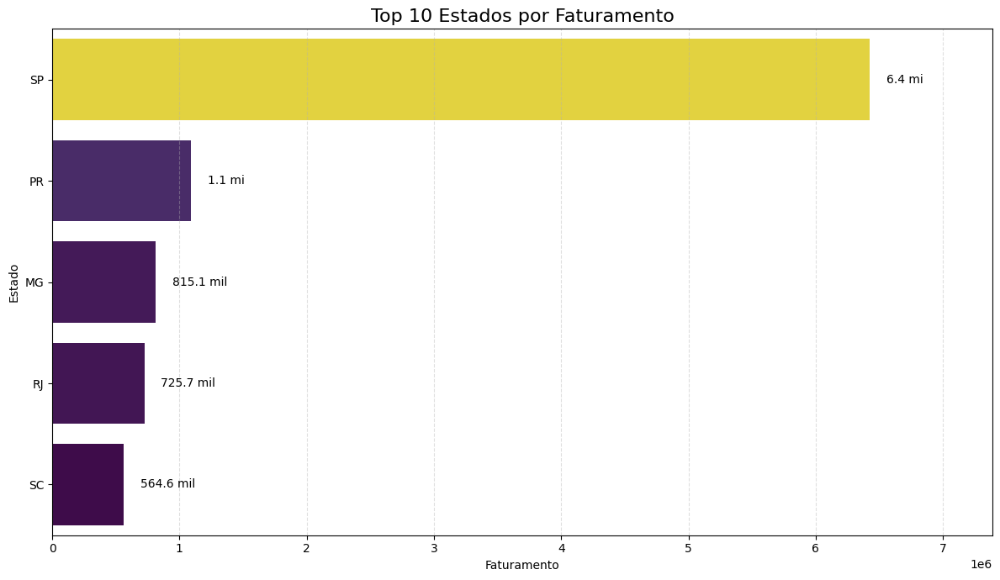

In [53]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Remover estados inválidos
estado_stats = estado_stats[estado_stats['estado'] != "Não Encontrado"]

# Selecionar os top 10 estados por faturamento
top_estados = estado_stats.sort_values(by='faturamento_total', ascending=False).head(5)

# Ordenar para o gráfico horizontal (de baixo pra cima)
top_estados = top_estados.sort_values(by='faturamento_total', ascending=False)

# Normalizar para mapa de cores
norm = plt.Normalize(top_estados['faturamento_total'].min(), top_estados['faturamento_total'].max())
colors = plt.cm.viridis(norm(top_estados['faturamento_total']))  # ou qualquer outro colormap

# Função para formatar valores em mil ou milhões
def format_milhar_milhao(valor):
    if valor >= 1_000_000:
        return f'{valor / 1_000_000:.1f} mi'
    else:
        return f'{valor / 1_000:.1f} mil'

# Plot
plt.figure(figsize=(12, 7))
ax = sns.barplot(
    x='faturamento_total',
    y='estado',
    data=top_estados,
    palette=colors
)

# Adicionar rótulos nas barras
for i, (valor, estado) in enumerate(zip(top_estados['faturamento_total'], top_estados['estado'])):
    ax.text(
        valor + 0.02 * top_estados['faturamento_total'].max(),  # deslocamento horizontal
        i,  # posição vertical
        format_milhar_milhao(valor),
        va='center',
        fontsize=10,
        color='black'
    )

# Ajustes de layout
plt.title('Top 10 Estados por Faturamento', fontsize=16)
plt.xlabel('Faturamento')
plt.ylabel('Estado')
plt.grid(axis='x', linestyle='--', alpha=0.4)

# Aumentar o limite do eixo X para dar espaço aos rótulos
plt.xlim(0, top_estados['faturamento_total'].max() * 1.15)

plt.tight_layout()
plt.show()


4. Mapa de faturamento por região

In [54]:
import plotly.express as px

# Consolidar faturamento único por pedido
df_pedidos = df_2_v.groupby("pedido", as_index=False).agg({
    "faturamento": "first",
    "latitude": "first",
    "longitude": "first"
})

# Mapa com bolas quentes
mapa_bolhas = px.scatter_mapbox(
    df_pedidos,
    lat="latitude",
    lon="longitude",
    size="faturamento",              
    color="faturamento",             
    color_continuous_scale="OrRd",   # laranja → vermelho
    hover_data={"faturamento": True},
    zoom=3,
    center={"lat": -15.8, "lon": -47.9},  
    height=700,
    width=1000,
    title="Faturamento por Região"
)

# Ajustar escala de tamanho
mapa_bolhas.update_traces(
    marker=dict(
        sizemode="area",   # mantém proporção pela área da bolha
        sizeref=2.*max(df_pedidos["faturamento"])/(40.**2),  # controla bolha máxima
        sizemin=3          # tamanho mínimo
    )
)

# Estilo do mapa
mapa_bolhas.update_layout(mapbox_style="open-street-map")

mapa_bolhas.show()
